# USAD

## Environment

In [1]:
!rm -r sample_data

rm: cannot remove 'sample_data': No such file or directory


In [2]:
!git clone https://github.com/manigalati/usad

In [3]:
%cd usad

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import torch
import torch.nn as nn

from utils import *
from usad import *

In [2]:
!nvidia-smi -L

device = get_default_device()

GPU 0: NVIDIA GeForce GTX 1080 Ti (UUID: GPU-544ce3d5-6b82-7735-9697-1b5de62c925b)
GPU 1: NVIDIA GeForce GTX 1080 Ti (UUID: GPU-dcaf0d0d-7c21-a1fb-2639-e92e3b7923e7)
GPU 2: NVIDIA GeForce GTX 1080 Ti (UUID: GPU-f5091519-619d-14a3-8e35-02955c8bb015)
GPU 3: NVIDIA GeForce GTX 1080 Ti (UUID: GPU-a2c0b088-874d-2aa5-2282-ae85dca0d486)


## EDA - Data Pre-Processing

### Download dataset

In [3]:
!mkdir input
#normal period
!python gdrivedl.py https://drive.google.com/open?id=1rVJ5ry5GG-ZZi5yI4x9lICB8VhErXwCw input/
#anomalies
!python gdrivedl.py https://drive.google.com/open?id=1iDYc0OEmidN712fquOBRFjln90SbpaE7 input/

input/SWaT_Dataset_Normal_v1.csv
[                                                  ] 0.00MB/163.77MB
input/SWaT_Dataset_Attack_v0.csv
[                                                  ] 0.00MB/127.27MB


### Normal period

In [3]:
#Read data
normal = pd.read_csv("data/SWaT_Dataset_Normal_v1.csv")#, nrows=1000)
normal = normal.drop(["Timestamp" , "Normal/Attack" ] , axis = 1)
normal.shape

/tmp/ipykernel_15221/1496298649.py:2: DtypeWarning: Columns (26) have mixed types. Specify dtype option on import or set low_memory=False.
  normal = pd.read_csv("data/SWaT_Dataset_Normal_v1.csv")#, nrows=1000)


(495000, 51)

In [4]:
normal

,FIT101,LIT101,MV101,P101,P102,AIT201,AIT202,AIT203,FIT201,MV201,...,FIT504,P501,P502,PIT501,PIT502,PIT503,FIT601,P601,P602,P603
0,0,"124,3135",1,1,1,"251,9226","8,313446","312,7916",0,1,...,0,1,1,"9,100231",0,"3,3485","0,0002563035",1,1,1
1,0,"124,392",1,1,1,"251,9226","8,313446","312,7916",0,1,...,0,1,1,"9,100231",0,"3,3485","0,0002563035",1,1,1
2,0,"124,4705",1,1,1,"251,9226","8,313446","312,7916",0,1,...,0,1,1,"9,100231",0,"3,3485","0,0002563035",1,1,1
3,0,"124,6668",1,1,1,"251,9226","8,313446","312,7916",0,1,...,0,1,1,"9,100231",0,"3,3485","0,0002563035",1,1,1
4,0,"124,5098",1,1,1,"251,9226","8,313446","312,7916",0,1,...,0,1,1,"9,100231",0,"3,3485","0,0002563035",1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
494995,"2,460366","523,043",2,2,1,"262,0161","8,396437","328,5055","2,442316",2,...,"0,3086186",2,1,"250,8171","1,778105","189,8552","0,0001281517",1,1,1
494996,"2,448836","522,9645",2,2,1,"262,0161","8,396437","328,5055","2,442316",2,...,"0,3086186",2,1,"250,8171","1,778105","189,5027","0,0001281517",1,1,1
494997,"2,434744","522,886",2,2,1,"262,0161","8,396437","328,6337","2,444879",2,...,"0,3086186",2,1,"250,8171","1,778105","189,5027","0,0001281517",1,1,1
494998,"2,428338","522,9252",2,2,1,"262,0161","8,396437","328,6337","2,445391",2,...,"0,3086186",2,1,"250,8171","1,649953","189,5027","0,0001281517",1,1,1


In [5]:
# Transform all columns into float64
for i in list(normal): 
    normal[i]=normal[i].apply(lambda x: str(x).replace("," , "."))
normal = normal.astype(float)

#### Normalization

In [6]:
from sklearn import preprocessing
min_max_scaler = preprocessing.MinMaxScaler()

x = normal.values
x_scaled = min_max_scaler.fit_transform(x)
normal = pd.DataFrame(x_scaled)

In [7]:
normal

,0,1,2,3,4,5,6,7,8,9,...,41,42,43,44,45,46,47,48,49,50
0,0.000000,0.005294,0.5,0.0,0.0,0.012291,0.075099,0.002009,0.000000,0.5,...,0.000000,0.0,0.0,0.000814,0.000000,0.001217,0.000147,0.0,0.0,0.0
1,0.000000,0.005407,0.5,0.0,0.0,0.012291,0.075099,0.002009,0.000000,0.5,...,0.000000,0.0,0.0,0.000814,0.000000,0.001217,0.000147,0.0,0.0,0.0
2,0.000000,0.005520,0.5,0.0,0.0,0.012291,0.075099,0.002009,0.000000,0.5,...,0.000000,0.0,0.0,0.000814,0.000000,0.001217,0.000147,0.0,0.0,0.0
3,0.000000,0.005801,0.5,0.0,0.0,0.012291,0.075099,0.002009,0.000000,0.5,...,0.000000,0.0,0.0,0.000814,0.000000,0.001217,0.000147,0.0,0.0,0.0
4,0.000000,0.005576,0.5,0.0,0.0,0.012291,0.075099,0.002009,0.000000,0.5,...,0.000000,0.0,0.0,0.000814,0.000000,0.001217,0.000147,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
494995,0.896278,0.577415,1.0,1.0,0.0,0.496158,0.188845,0.063586,0.981663,1.0,...,0.973530,1.0,0.0,0.945937,0.484716,0.945414,0.000073,0.0,0.0,0.0
494996,0.892078,0.577302,1.0,1.0,0.0,0.496158,0.188845,0.063586,0.981663,1.0,...,0.973530,1.0,0.0,0.945937,0.484716,0.943629,0.000073,0.0,0.0,0.0
494997,0.886944,0.577190,1.0,1.0,0.0,0.496158,0.188845,0.064088,0.982693,1.0,...,0.973530,1.0,0.0,0.945937,0.484716,0.943629,0.000073,0.0,0.0,0.0
494998,0.884611,0.577246,1.0,1.0,0.0,0.496158,0.188845,0.064088,0.982899,1.0,...,0.973530,1.0,0.0,0.945937,0.449782,0.943629,0.000073,0.0,0.0,0.0


### Attack

In [8]:
#Read data
attack = pd.read_csv("data/SWaT_Dataset_Attack_v0.csv",sep=";")#, nrows=1000)
labels = [ float(label!= 'Normal' ) for label  in attack["Normal/Attack"].values]
attack = attack.drop(["Timestamp" , "Normal/Attack" ] , axis = 1)
attack.shape

/tmp/ipykernel_15221/2629613335.py:2: DtypeWarning: Columns (1,9,28,46) have mixed types. Specify dtype option on import or set low_memory=False.
  attack = pd.read_csv("data/SWaT_Dataset_Attack_v0.csv",sep=";")#, nrows=1000)


(449919, 51)

In [9]:
attack

,FIT101,LIT101,MV101,P101,P102,AIT201,AIT202,AIT203,FIT201,MV201,...,FIT504,P501,P502,PIT501,PIT502,PIT503,FIT601,P601,P602,P603
0,"2,427057","522,8467",2,2,1,"262,0161","8,396437","328,6337","2,445391",2,...,"0,3077859",2,1,"250,8652","1,649953","189,5988","0,000128152",1,1,1
1,"2,446274","522,886",2,2,1,"262,0161","8,396437","328,6337","2,445391",2,...,"0,3077859",2,1,"250,8652","1,649953","189,6789","0,000128152",1,1,1
2,"2,489191","522,8467",2,2,1,"262,0161","8,394514","328,6337","2,442316",2,...,"0,3086186",2,1,"250,8812","1,649953","189,6789","0,000128152",1,1,1
3,"2,53435","522,9645",2,2,1,"262,0161","8,394514","328,6337","2,442316",2,...,"0,3086186",2,1,"250,8812","1,649953","189,6148","0,000128152",1,1,1
4,"2,56926","523,4748",2,2,1,"262,0161","8,394514","328,6337","2,443085",2,...,"0,3086186",2,1,"250,8812","1,649953","189,5027","0,000128152",1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
449914,"2,559972","519,5495",2,2,1,"168,0979","8,638683","301,9226","2,459488",2,...,"0,3065689",2,1,"251,1535","0,8650241","189,022",0,1,1,1
449915,"2,549082","520,4131",2,2,1,"168,0979","8,638683","301,9226","2,459488",2,...,"0,3065689",2,1,"251,0734","0,8650241","188,9259",0,1,1,1
449916,"2,531467","520,6878",2,2,1,"168,0979","8,638683","301,9226","2,460129",2,...,"0,3065689",2,1,"251,0734","0,8650241","188,9259",0,1,1,1
449917,"2,521218","520,7271",2,2,1,"168,0979","8,638683","301,9226","2,460129",2,...,"0,3079781",2,1,"251,0734","0,8650241","188,9259",0,1,1,1


In [10]:
labels

[0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0

In [11]:
label_df = pd.DataFrame(labels)
label_df[0].unique()

array([0., 1.])

In [12]:
label_df[0].sum(), len(label_df), label_df[0].sum() / len(label_df)

(54621.0, 449919, 0.12140185233342002)

In [13]:
# Transform all columns into float64
for i in list(attack):
    attack[i]=attack[i].apply(lambda x: str(x).replace("," , "."))
attack = attack.astype(float)

#### Normalization

In [14]:
from sklearn import preprocessing

x = attack.values 
x_scaled = min_max_scaler.transform(x)
attack = pd.DataFrame(x_scaled)

In [15]:
attack

,0,1,2,3,4,5,6,7,8,9,...,41,42,43,44,45,46,47,48,49,50
0,0.884144,0.577133,1.0,1.0,0.0,0.496158,0.188845,0.064088,0.982899,1.0,...,0.970903,1.0,0.0,0.946125,0.449782,0.944116,0.000073,0.0,0.0,0.0
1,0.891145,0.577190,1.0,1.0,0.0,0.496158,0.188845,0.064088,0.982899,1.0,...,0.970903,1.0,0.0,0.946125,0.449782,0.944521,0.000073,0.0,0.0,0.0
2,0.906779,0.577133,1.0,1.0,0.0,0.496158,0.186209,0.064088,0.981663,1.0,...,0.973530,1.0,0.0,0.946188,0.449782,0.944521,0.000073,0.0,0.0,0.0
3,0.923230,0.577302,1.0,1.0,0.0,0.496158,0.186209,0.064088,0.981663,1.0,...,0.973530,1.0,0.0,0.946188,0.449782,0.944197,0.000073,0.0,0.0,0.0
4,0.935947,0.578034,1.0,1.0,0.0,0.496158,0.186209,0.064088,0.981972,1.0,...,0.973530,1.0,0.0,0.946188,0.449782,0.943629,0.000073,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
449914,0.932563,0.572402,1.0,1.0,0.0,-4.006131,0.520861,-0.040583,0.988565,1.0,...,0.967064,1.0,0.0,0.947253,0.235808,0.941196,0.000000,0.0,0.0,0.0
449915,0.928596,0.573641,1.0,1.0,0.0,-4.006131,0.520861,-0.040583,0.988565,1.0,...,0.967064,1.0,0.0,0.946940,0.235808,0.940709,0.000000,0.0,0.0,0.0
449916,0.922179,0.574035,1.0,1.0,0.0,-4.006131,0.520861,-0.040583,0.988822,1.0,...,0.967064,1.0,0.0,0.946940,0.235808,0.940709,0.000000,0.0,0.0,0.0
449917,0.918446,0.574092,1.0,1.0,0.0,-4.006131,0.520861,-0.040583,0.988822,1.0,...,0.971509,1.0,0.0,0.946940,0.235808,0.940709,0.000000,0.0,0.0,0.0


### Windows

In [22]:
window_size=9 #12

In [23]:
np.arange(window_size)[None, :]

array([[0, 1, 2, 3, 4, 5, 6, 7, 8]])

In [24]:
np.arange(normal.shape[0]-window_size)[:, None]

array([[     0],
       [     1],
       [     2],
       ...,
       [494988],
       [494989],
       [494990]])

In [25]:
np.arange(window_size)[None, :] + np.arange(normal.shape[0]-window_size)[:, None]
# In this way we select the indices to extract the windows ---> overlapping windows, stride = 1

array([[     0,      1,      2, ...,      6,      7,      8],
       [     1,      2,      3, ...,      7,      8,      9],
       [     2,      3,      4, ...,      8,      9,     10],
       ...,
       [494988, 494989, 494990, ..., 494994, 494995, 494996],
       [494989, 494990, 494991, ..., 494995, 494996, 494997],
       [494990, 494991, 494992, ..., 494996, 494997, 494998]])

In [26]:
windows_normal=normal.values[np.arange(window_size)[None, :] + np.arange(normal.shape[0]-window_size)[:, None]]
windows_normal.shape

(494991, 9, 51)

In [27]:
def windows(dataframe, window_size):
  total_length = dataframe.shape[0]
  output = []
  data = np.array(dataframe)
  for i in range(total_length - window_size + 1):
    # find the end of this sequence
    end_ix = i + window_size
    # check if we are beyond the dataset length for this building
    if end_ix > total_length-1:
      break
    output.append(data[i : (i + window_size),:])
  return np.stack(output)

In [28]:
try_windows_normal = windows(normal, window_size)
try_windows_normal.shape

(494991, 9, 51)

In [29]:
windows_normal

array([[[0.        , 0.00529434, 0.5       , ..., 0.        ,
         0.        , 0.        ],
        [0.        , 0.00540698, 0.5       , ..., 0.        ,
         0.        , 0.        ],
        [0.        , 0.00551961, 0.5       , ..., 0.        ,
         0.        , 0.        ],
        ...,
        [0.        , 0.00416783, 0.5       , ..., 0.        ,
         0.        , 0.        ],
        [0.        , 0.00399895, 0.5       , ..., 0.        ,
         0.        , 0.        ],
        [0.        , 0.00371729, 0.5       , ..., 0.        ,
         0.        , 0.        ]],

       [[0.        , 0.00540698, 0.5       , ..., 0.        ,
         0.        , 0.        ],
        [0.        , 0.00551961, 0.5       , ..., 0.        ,
         0.        , 0.        ],
        [0.        , 0.00580128, 0.5       , ..., 0.        ,
         0.        , 0.        ],
        ...,
        [0.        , 0.00399895, 0.5       , ..., 0.        ,
         0.        , 0.        ],
        [0. 

In [30]:
try_windows_normal

array([[[0.        , 0.00529434, 0.5       , ..., 0.        ,
         0.        , 0.        ],
        [0.        , 0.00540698, 0.5       , ..., 0.        ,
         0.        , 0.        ],
        [0.        , 0.00551961, 0.5       , ..., 0.        ,
         0.        , 0.        ],
        ...,
        [0.        , 0.00416783, 0.5       , ..., 0.        ,
         0.        , 0.        ],
        [0.        , 0.00399895, 0.5       , ..., 0.        ,
         0.        , 0.        ],
        [0.        , 0.00371729, 0.5       , ..., 0.        ,
         0.        , 0.        ]],

       [[0.        , 0.00540698, 0.5       , ..., 0.        ,
         0.        , 0.        ],
        [0.        , 0.00551961, 0.5       , ..., 0.        ,
         0.        , 0.        ],
        [0.        , 0.00580128, 0.5       , ..., 0.        ,
         0.        , 0.        ],
        ...,
        [0.        , 0.00399895, 0.5       , ..., 0.        ,
         0.        , 0.        ],
        [0. 

In [31]:
windows_attack=attack.values[np.arange(window_size)[None, :] + np.arange(attack.shape[0]-window_size)[:, None]]
windows_attack.shape

(449910, 9, 51)

In [32]:
windows_attack

array([[[0.88414414, 0.57713312, 1.        , ..., 0.        ,
         0.        , 0.        ],
        [0.89114463, 0.57718951, 1.        , ..., 0.        ,
         0.        , 0.        ],
        [0.90677872, 0.57713312, 1.        , ..., 0.        ,
         0.        , 0.        ],
        ...,
        [0.9606811 , 0.57893544, 1.        , ..., 0.        ,
         0.        , 0.        ],
        [0.9661647 , 0.57910447, 1.        , ..., 0.        ,
         0.        , 0.        ],
        [0.96744845, 0.57949877, 1.        , ..., 0.        ,
         0.        , 0.        ]],

       [[0.89114463, 0.57718951, 1.        , ..., 0.        ,
         0.        , 0.        ],
        [0.90677872, 0.57713312, 1.        , ..., 0.        ,
         0.        , 0.        ],
        [0.92322953, 0.57730214, 1.        , ..., 0.        ,
         0.        , 0.        ],
        ...,
        [0.9661647 , 0.57910447, 1.        , ..., 0.        ,
         0.        , 0.        ],
        [0.9

## Training

In [33]:
import torch.utils.data as data_utils

BATCH_SIZE =  7919
N_EPOCHS = 100
hidden_size = 100

w_size=windows_normal.shape[1]*windows_normal.shape[2] #12*51 = 612
z_size=windows_normal.shape[1]*hidden_size # 12*100 = 1200

#ENCODER:
#612 --> 306
#306 --> 153
#153 --> 1200

windows_normal_train = windows_normal[:int(np.floor(.8 *  windows_normal.shape[0]))]
windows_normal_val = windows_normal[int(np.floor(.8 *  windows_normal.shape[0])):int(np.floor(windows_normal.shape[0]))]

train_loader = torch.utils.data.DataLoader(data_utils.TensorDataset(
    torch.from_numpy(windows_normal_train).float().view(([windows_normal_train.shape[0],w_size]))
) , batch_size=BATCH_SIZE, shuffle=False, num_workers=0)

val_loader = torch.utils.data.DataLoader(data_utils.TensorDataset(
    torch.from_numpy(windows_normal_val).float().view(([windows_normal_val.shape[0],w_size]))
) , batch_size=BATCH_SIZE, shuffle=False, num_workers=0)

test_loader = torch.utils.data.DataLoader(data_utils.TensorDataset(
    torch.from_numpy(windows_attack).float().view(([windows_attack.shape[0],w_size]))
) , batch_size=BATCH_SIZE, shuffle=False, num_workers=0)

model = UsadModel(w_size, z_size)
model = to_device(model,device)

In [34]:
history = training(N_EPOCHS,model,train_loader,val_loader)

Epoch [0], val_loss1: 0.0264, val_loss2: 0.0269
Epoch [1], val_loss1: 0.0293, val_loss2: -0.0033
Epoch [2], val_loss1: 0.0229, val_loss2: -0.0103
Epoch [3], val_loss1: 0.0340, val_loss2: -0.0259
Epoch [4], val_loss1: 0.0389, val_loss2: -0.0275
Epoch [5], val_loss1: 0.0380, val_loss2: -0.0330
Epoch [6], val_loss1: 0.0384, val_loss2: -0.0346
Epoch [7], val_loss1: 0.0377, val_loss2: -0.0347
Epoch [8], val_loss1: 0.0384, val_loss2: -0.0357
Epoch [9], val_loss1: 0.0373, val_loss2: -0.0351
Epoch [10], val_loss1: 0.0413, val_loss2: -0.0356
Epoch [11], val_loss1: 0.0451, val_loss2: -0.0405
Epoch [12], val_loss1: 0.0424, val_loss2: -0.0367
Epoch [13], val_loss1: 0.0431, val_loss2: -0.0402
Epoch [14], val_loss1: 0.0418, val_loss2: -0.0398
Epoch [15], val_loss1: 0.1471, val_loss2: -0.1346
Epoch [16], val_loss1: 0.1463, val_loss2: -0.1364
Epoch [17], val_loss1: 0.1466, val_loss2: -0.1374
Epoch [18], val_loss1: 0.1471, val_loss2: -0.1384
Epoch [19], val_loss1: 0.1473, val_loss2: -0.1391
Epoch [20],

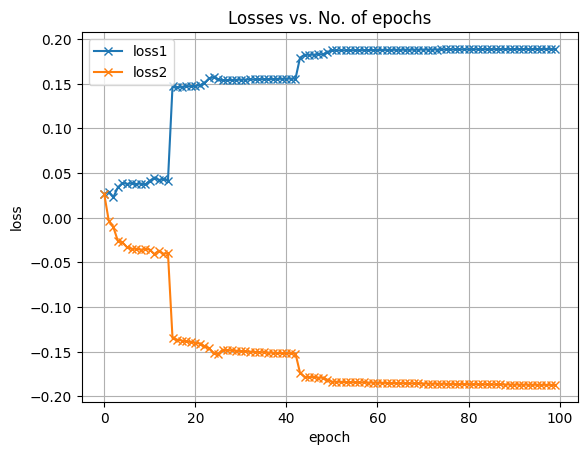

In [35]:
plot_history(history)

In [36]:
torch.save({
            'encoder': model.encoder.state_dict(),
            'decoder1': model.decoder1.state_dict(),
            'decoder2': model.decoder2.state_dict()
            }, "checkpoints/usad_model2.pth")

## Testing

In [30]:
checkpoint = torch.load("checkpoints/usad_model.pth") #usad_model.pth con window = 12; usad_model2.pth con window = 9

model.encoder.load_state_dict(checkpoint['encoder'])
model.decoder1.load_state_dict(checkpoint['decoder1'])
model.decoder2.load_state_dict(checkpoint['decoder2'])

<All keys matched successfully>

In [37]:
results=testing(model,test_loader)

In [38]:
len(results)

57

In [39]:
len(results[0])

7919

In [40]:
results

[tensor([0.0806, 0.0806, 0.0806,  ..., 0.1384, 0.1384, 0.1385], device='cuda:0'),
 tensor([0.1385, 0.1386, 0.1386,  ..., 0.2111, 0.2113, 0.2115], device='cuda:0'),
 tensor([0.2117, 0.2119, 0.2120,  ..., 0.0820, 0.0819, 0.0819], device='cuda:0'),
 tensor([0.0819, 0.0819, 0.0819,  ..., 0.0914, 0.0913, 0.0913], device='cuda:0'),
 tensor([0.0913, 0.0912, 0.0912,  ..., 0.0850, 0.0849, 0.0848], device='cuda:0'),
 tensor([0.0848, 0.0847, 0.0847,  ..., 0.1186, 0.1186, 0.1187], device='cuda:0'),
 tensor([0.1187, 0.1188, 0.1189,  ..., 0.0970, 0.0981, 0.0990], device='cuda:0'),
 tensor([0.0998, 0.1004, 0.0999,  ..., 0.1370, 0.1370, 0.1370], device='cuda:0'),
 tensor([0.1370, 0.1370, 0.1370,  ..., 0.1562, 0.1563, 0.1562], device='cuda:0'),
 tensor([0.1562, 0.1561, 0.1561,  ..., 0.0844, 0.0844, 0.0844], device='cuda:0'),
 tensor([0.0844, 0.0844, 0.0844,  ..., 0.0811, 0.0811, 0.0811], device='cuda:0'),
 tensor([0.0811, 0.0812, 0.0812,  ..., 0.0805, 0.0805, 0.0805], device='cuda:0'),
 tensor([0.0806,

In [41]:
# Qui va ad ottenere le label per ogni finestra
# Input modello è una lista di array, ognuno corrispondente a una sliding window con stride = 1 sui dati originali
# Quindi dobbiamo applicare la sliding window anche sulle label
windows_labels=[]
for i in range(len(labels)-window_size):
    windows_labels.append(list(np.int_(labels[i:i+window_size])))

In [42]:
windows_labels

[[0, 0, 0, 0, 0, 0, 0, 0, 0],
 [0, 0, 0, 0, 0, 0, 0, 0, 0],
 [0, 0, 0, 0, 0, 0, 0, 0, 0],
 [0, 0, 0, 0, 0, 0, 0, 0, 0],
 [0, 0, 0, 0, 0, 0, 0, 0, 0],
 [0, 0, 0, 0, 0, 0, 0, 0, 0],
 [0, 0, 0, 0, 0, 0, 0, 0, 0],
 [0, 0, 0, 0, 0, 0, 0, 0, 0],
 [0, 0, 0, 0, 0, 0, 0, 0, 0],
 [0, 0, 0, 0, 0, 0, 0, 0, 0],
 [0, 0, 0, 0, 0, 0, 0, 0, 0],
 [0, 0, 0, 0, 0, 0, 0, 0, 0],
 [0, 0, 0, 0, 0, 0, 0, 0, 0],
 [0, 0, 0, 0, 0, 0, 0, 0, 0],
 [0, 0, 0, 0, 0, 0, 0, 0, 0],
 [0, 0, 0, 0, 0, 0, 0, 0, 0],
 [0, 0, 0, 0, 0, 0, 0, 0, 0],
 [0, 0, 0, 0, 0, 0, 0, 0, 0],
 [0, 0, 0, 0, 0, 0, 0, 0, 0],
 [0, 0, 0, 0, 0, 0, 0, 0, 0],
 [0, 0, 0, 0, 0, 0, 0, 0, 0],
 [0, 0, 0, 0, 0, 0, 0, 0, 0],
 [0, 0, 0, 0, 0, 0, 0, 0, 0],
 [0, 0, 0, 0, 0, 0, 0, 0, 0],
 [0, 0, 0, 0, 0, 0, 0, 0, 0],
 [0, 0, 0, 0, 0, 0, 0, 0, 0],
 [0, 0, 0, 0, 0, 0, 0, 0, 0],
 [0, 0, 0, 0, 0, 0, 0, 0, 0],
 [0, 0, 0, 0, 0, 0, 0, 0, 0],
 [0, 0, 0, 0, 0, 0, 0, 0, 0],
 [0, 0, 0, 0, 0, 0, 0, 0, 0],
 [0, 0, 0, 0, 0, 0, 0, 0, 0],
 [0, 0, 0, 0, 0, 0, 0, 0, 0],
 [0, 0, 0,

In [43]:
y_test = [1.0 if (np.sum(window) > 0) else 0 for window in windows_labels ]
# Qui vado a dare le label 1 per ogni finestra: se tutta la finestra contiene label = 0, allora y_test(t) = 0, altrimenti = 1

In [44]:
print(y_test)

[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

In [45]:
y_pred=np.concatenate([torch.stack(results[:-1]).flatten().detach().cpu().numpy(),
                              results[-1].flatten().detach().cpu().numpy()])

In [46]:
y_pred

array([0.08060668, 0.0806013 , 0.08056639, ..., 0.5906296 , 0.5905223 ,
       0.590394  ], dtype=float32)

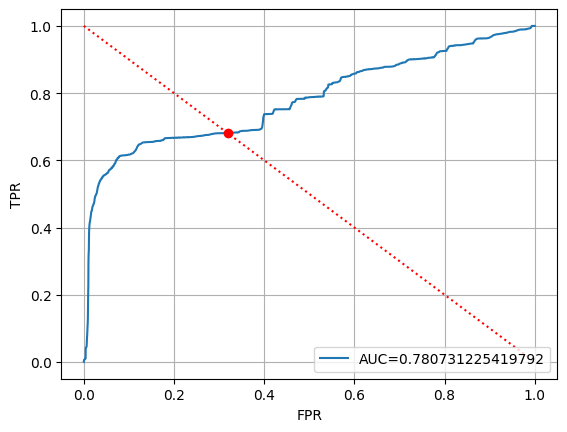

In [47]:
threshold=ROC(y_test,y_pred)

In [48]:
threshold

array([0.48775464], dtype=float32)

In [49]:
y_pred_ = np.zeros(y_pred.shape[0])

In [50]:
y_pred_[y_pred >= threshold] = 1

In [51]:
y_pred_

array([0., 0., 0., ..., 1., 1., 1.])

In [52]:
np.array(y_test)

array([0., 0., 0., ..., 0., 0., 0.])

In [53]:
import sklearn

In [54]:
sklearn.metrics.roc_auc_score(y_test, y_pred_)

0.6812767212070592

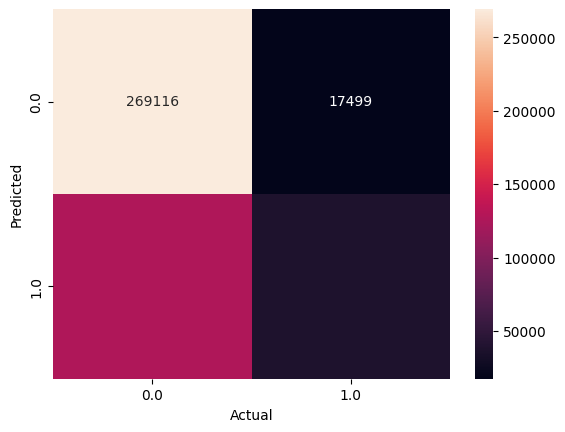

In [55]:
confusion_matrix(np.array(y_test), y_pred_)

In [56]:
print(sklearn.metrics.classification_report(y_test, y_pred_))

              precision    recall  f1-score   support

         0.0       0.94      0.68      0.79    395009
         1.0       0.23      0.68      0.34     54901

    accuracy                           0.68    449910
   macro avg       0.58      0.68      0.57    449910
weighted avg       0.85      0.68      0.74    449910



In [57]:
y_pred.min(), y_pred.max()

(0.07190495, 0.6899402)

In [58]:
threshold = np.percentile(y_pred, 93)
print(threshold)
y_pred_ = np.zeros(y_pred.shape[0])
y_pred_[y_pred >= threshold] = 1

0.6005884629487991


In [59]:
len(y_pred_)

449910

In [60]:
y_pred_.sum()

31495.0

In [61]:
y_pred_.sum()/len(y_pred_)

0.07000288946678225

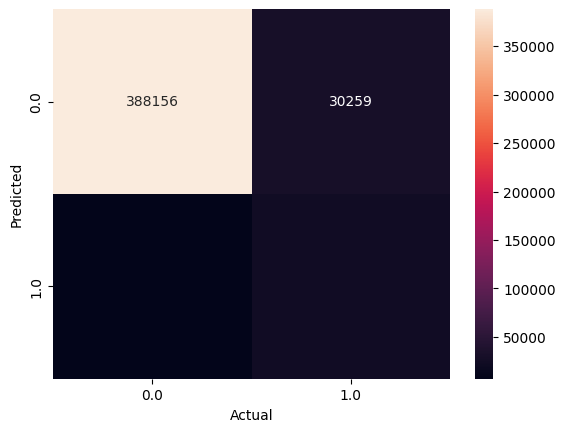

In [62]:
confusion_matrix(np.array(y_test), y_pred_)

In [63]:
print(sklearn.metrics.classification_report(y_test, y_pred_))

              precision    recall  f1-score   support

         0.0       0.93      0.98      0.95    395009
         1.0       0.78      0.45      0.57     54901

    accuracy                           0.92    449910
   macro avg       0.86      0.72      0.76    449910
weighted avg       0.91      0.92      0.91    449910



In [64]:
sklearn.metrics.roc_auc_score(y_test, y_pred_)

0.7157476557754038

# Reconstruction

Let's try to see what the actual reconstruction looks like.

We are going to firstly create non overlapping windows from the attack dataset, then we pass them to the model and take the corresponding result, to then perform anomaly detection.

In [65]:
def windows_non_overlapping(dataframe, window_size):
  total_length = dataframe.shape[0]
  output = []
  data = np.array(dataframe)
  for i in range(0, total_length - window_size + 1, window_size):
    # find the end of this sequence
    end_ix = i + window_size
    # check if we are beyond the dataset length for this building
    #if end_ix > total_length-1:
     # break
    output.append(data[i : (i + window_size),:])
  return np.stack(output)

In [66]:
attack_wndw = windows_non_overlapping(attack, window_size)

In [67]:
attack_wndw.shape

(49991, 9, 51)

In [68]:
attack_wndw

array([[[0.88414414, 0.57713312, 1.        , ..., 0.        ,
         0.        , 0.        ],
        [0.89114463, 0.57718951, 1.        , ..., 0.        ,
         0.        , 0.        ],
        [0.90677872, 0.57713312, 1.        , ..., 0.        ,
         0.        , 0.        ],
        ...,
        [0.9606811 , 0.57893544, 1.        , ..., 0.        ,
         0.        , 0.        ],
        [0.9661647 , 0.57910447, 1.        , ..., 0.        ,
         0.        , 0.        ],
        [0.96744845, 0.57949877, 1.        , ..., 0.        ,
         0.        , 0.        ]],

       [[0.96534834, 0.5788792 , 1.        , ..., 0.        ,
         0.        , 0.        ],
        [0.95823127, 0.57893544, 1.        , ..., 0.        ,
         0.        , 0.        ],
        [0.95508092, 0.57842865, 1.        , ..., 0.        ,
         0.        , 0.        ],
        ...,
        [0.93548012, 0.5768516 , 1.        , ..., 0.        ,
         0.        , 0.        ],
        [0.9

In [69]:
test_loader = torch.utils.data.DataLoader(data_utils.TensorDataset(
    torch.from_numpy(attack_wndw).float().contiguous().view(([attack_wndw.shape[0],w_size]))
) , batch_size=BATCH_SIZE, shuffle=False, num_workers=0)

In [70]:
results_non_over, w1_non_over, w2_non_over = testing_prova(model, test_loader)

In [71]:
results_non_over

[tensor([0.0806, 0.0807, 0.0810,  ..., 0.1562, 0.1563, 0.1563], device='cuda:0'),
 tensor([0.1562, 0.1561, 0.1565,  ..., 0.1332, 0.1329, 0.1325], device='cuda:0'),
 tensor([0.1320, 0.1307, 0.1302,  ..., 0.3277, 0.3275, 0.3275], device='cuda:0'),
 tensor([0.3267, 0.3271, 0.3268,  ..., 0.5087, 0.5087, 0.5091], device='cuda:0'),
 tensor([0.5083, 0.5085, 0.5083,  ..., 0.4799, 0.4794, 0.4791], device='cuda:0'),
 tensor([0.4797, 0.4791, 0.4787,  ..., 0.5387, 0.5385, 0.5387], device='cuda:0'),
 tensor([0.5387, 0.5387, 0.5427,  ..., 0.5896, 0.5905, 0.5903], device='cuda:0')]

In [72]:
results_non_over[0].size(), results_non_over[-1].size()

(torch.Size([7919]), torch.Size([2477]))

In [74]:
w1_non_over

[tensor([[9.9710e-01, 5.4730e-01, 9.9607e-01,  ..., 3.2534e-09, 1.1840e-05,
          2.1131e-10],
         [9.9738e-01, 5.4629e-01, 9.9636e-01,  ..., 3.1420e-09, 1.2240e-05,
          2.0179e-10],
         [9.9635e-01, 5.4993e-01, 9.9532e-01,  ..., 3.5148e-09, 1.0902e-05,
          2.3583e-10],
         ...,
         [9.9999e-01, 6.9117e-01, 9.9996e-01,  ..., 1.4975e-06, 3.2041e-04,
          9.1878e-07],
         [9.9999e-01, 6.8564e-01, 9.9996e-01,  ..., 1.3103e-06, 3.4301e-04,
          7.9854e-07],
         [9.9999e-01, 6.9065e-01, 9.9996e-01,  ..., 1.4364e-06, 3.1971e-04,
          8.8034e-07]], device='cuda:0'),
 tensor([[9.9999e-01, 6.9171e-01, 9.9996e-01,  ..., 1.4812e-06, 3.1519e-04,
          9.0809e-07],
         [9.9999e-01, 6.8677e-01, 9.9996e-01,  ..., 1.3345e-06, 3.3525e-04,
          8.1273e-07],
         [9.9999e-01, 6.9263e-01, 9.9995e-01,  ..., 1.4648e-06, 3.0737e-04,
          8.9825e-07],
         ...,
         [4.1698e-01, 6.5049e-01, 7.7436e-01,  ..., 5.4553e-10

In [75]:
w2_non_over

[tensor([[1.0000e+00, 3.6556e-24, 1.0000e+00,  ..., 4.0432e-28, 7.3989e-28,
          9.2962e-21],
         [1.0000e+00, 3.6226e-24, 1.0000e+00,  ..., 4.0009e-28, 7.3208e-28,
          9.2259e-21],
         [1.0000e+00, 3.7226e-24, 1.0000e+00,  ..., 4.1298e-28, 7.5583e-28,
          9.4387e-21],
         ...,
         [1.0000e+00, 6.1765e-18, 1.0000e+00,  ..., 6.3164e-21, 7.9501e-21,
          1.4691e-15],
         [1.0000e+00, 5.9130e-18, 1.0000e+00,  ..., 6.0022e-21, 7.5533e-21,
          1.4163e-15],
         [1.0000e+00, 6.1177e-18, 1.0000e+00,  ..., 6.2465e-21, 7.8627e-21,
          1.4573e-15]], device='cuda:0'),
 tensor([[1.0000e+00, 6.1913e-18, 1.0000e+00,  ..., 6.3343e-21, 7.9731e-21,
          1.4720e-15],
         [1.0000e+00, 5.9904e-18, 1.0000e+00,  ..., 6.0941e-21, 7.6692e-21,
          1.4318e-15],
         [1.0000e+00, 6.2118e-18, 1.0000e+00,  ..., 6.3594e-21, 8.0056e-21,
          1.4761e-15],
         ...,
         [1.0000e+00, 2.4794e-21, 1.0000e+00,  ..., 7.5392e-25

## w1

In [76]:
len(w1_non_over), w1_non_over[0].size(), w1_non_over[-1].size()

(7, torch.Size([7919, 459]), torch.Size([2477, 459]))

In [103]:
# Fai reshape da [batch, 612] a [batch, 12, 51]
reshaped_w1 = [torch.reshape(w1_el, (w1_el.size()[0], int(w1_el.size()[1]/51), int(w1_el.size()[1]/9))) for w1_el in w1_non_over]

In [104]:
reshaped_w1[0].size(), reshaped_w1[-1].size()

(torch.Size([7919, 9, 51]), torch.Size([2477, 9, 51]))

In [105]:
#reshaped_w1 = [torch.flatten(w1_el) for w1_el in w1_non_over]
reshaped_w1_try = [torch.reshape(w1_el, (w1_el.size()[0]*w1_el.size()[1], w1_el.size()[2])) for w1_el in reshaped_w1]

In [106]:
reshaped_w1_try[0].size(), reshaped_w1_try[-1].size()

(torch.Size([71271, 51]), torch.Size([22293, 51]))

In [108]:
stacked = torch.stack(reshaped_w1_try[:-1])
stacked.shape

torch.Size([6, 71271, 51])

In [109]:
stacked_reshaped = torch.reshape(stacked, (stacked.size()[0] * stacked.size()[1], stacked.size()[2]))

In [111]:
stacked_reshaped.size()

torch.Size([427626, 51])

In [112]:
stacked_array = stacked_reshaped.cpu().numpy()
stacked_array

array([[9.9710029e-01, 5.4730248e-01, 9.9606848e-01, ..., 3.4314591e-09,
        1.6337224e-05, 1.2255833e-07],
       [9.9600369e-01, 5.0719970e-01, 9.9455500e-01, ..., 8.0341662e-09,
        7.9371074e-07, 9.0108569e-09],
       [9.9647009e-01, 5.4798955e-01, 9.9490166e-01, ..., 7.2193149e-09,
        7.2357216e-07, 1.0738074e-08],
       ...,
       [1.2093473e-02, 8.0591595e-01, 2.1353665e-01, ..., 1.0187062e-08,
        1.4302140e-08, 1.7080664e-08],
       [2.3225142e-02, 7.0591193e-01, 1.5243433e-01, ..., 4.0773170e-08,
        2.0481545e-09, 5.0647636e-10],
       [2.6522402e-02, 6.9599670e-01, 2.0804283e-01, ..., 1.3461723e-09,
        2.0017279e-07, 1.2670473e-10]], dtype=float32)

In [113]:
last_array = reshaped_w1_try[-1].cpu().numpy()
last_array

array([[2.2286335e-02, 7.3759884e-01, 2.5791988e-01, ..., 2.9807792e-10,
        4.1247654e-07, 3.0171103e-07],
       [1.9867154e-02, 6.1780173e-01, 1.9347937e-01, ..., 7.5801356e-09,
        2.8892753e-09, 1.5980072e-08],
       [1.4683351e-02, 6.4879501e-01, 2.0586826e-01, ..., 4.5363828e-09,
        9.8360409e-10, 2.0840223e-09],
       ...,
       [1.2533903e-02, 8.1069779e-01, 2.3589666e-01, ..., 9.1171001e-11,
        2.6933769e-10, 1.8911783e-10],
       [1.9590883e-02, 7.0703048e-01, 1.7192686e-01, ..., 7.7135975e-10,
        2.6723186e-11, 2.9068156e-12],
       [2.6195450e-02, 6.9013280e-01, 2.0982708e-01, ..., 1.1289655e-11,
        7.1159088e-09, 2.8109397e-13]], dtype=float32)

In [114]:
total = np.concatenate([stacked_array, last_array])

In [115]:
total.shape

(449919, 51)

In [116]:
total

array([[9.9710029e-01, 5.4730248e-01, 9.9606848e-01, ..., 3.4314591e-09,
        1.6337224e-05, 1.2255833e-07],
       [9.9600369e-01, 5.0719970e-01, 9.9455500e-01, ..., 8.0341662e-09,
        7.9371074e-07, 9.0108569e-09],
       [9.9647009e-01, 5.4798955e-01, 9.9490166e-01, ..., 7.2193149e-09,
        7.2357216e-07, 1.0738074e-08],
       ...,
       [1.2533903e-02, 8.1069779e-01, 2.3589666e-01, ..., 9.1171001e-11,
        2.6933769e-10, 1.8911783e-10],
       [1.9590883e-02, 7.0703048e-01, 1.7192686e-01, ..., 7.7135975e-10,
        2.6723186e-11, 2.9068156e-12],
       [2.6195450e-02, 6.9013280e-01, 2.0982708e-01, ..., 1.1289655e-11,
        7.1159088e-09, 2.8109397e-13]], dtype=float32)

## w2

In [117]:
# Fai reshape da [batch, 612] a [batch, 12, 51]
reshaped_w2 = [torch.reshape(w2_el, (w2_el.size()[0], int(w2_el.size()[1]/51), int(w2_el.size()[1]/9))) for w2_el in w2_non_over]

In [118]:
reshaped_w2[0].size(), reshaped_w2[-1].size()

(torch.Size([7919, 9, 51]), torch.Size([2477, 9, 51]))

In [119]:
reshaped_w2_try = [torch.reshape(w2_el, (w2_el.size()[0]*w2_el.size()[1], w2_el.size()[2])) for w2_el in reshaped_w2]

In [120]:
reshaped_w2_try[0].size(), reshaped_w2_try[-1].size()

(torch.Size([71271, 51]), torch.Size([22293, 51]))

In [121]:
stacked2 = torch.stack(reshaped_w2_try[:-1])
stacked2.shape

torch.Size([6, 71271, 51])

In [122]:
stacked_reshaped2 = torch.reshape(stacked2, (stacked2.size()[0] * stacked2.size()[1], stacked2.size()[2]))

In [123]:
stacked_reshaped2.size()

torch.Size([427626, 51])

In [124]:
stacked_array = stacked_reshaped2.cpu().numpy()
stacked_array

array([[1.00000000e+00, 3.65555737e-24, 1.00000000e+00, ...,
        6.49925182e-26, 5.64177284e-29, 1.09734115e-33],
       [1.00000000e+00, 5.22138867e-30, 1.00000000e+00, ...,
        2.73114385e-19, 2.87847886e-31, 6.18487596e-27],
       [1.00000000e+00, 9.65918968e-23, 1.00000000e+00, ...,
        2.31745484e-37, 4.12992778e-35, 4.54276831e-26],
       ...,
       [1.00000000e+00, 1.11744557e-16, 1.00000000e+00, ...,
        8.28218054e-28, 5.84957006e-24, 1.90025399e-21],
       [1.00000000e+00, 2.41788417e-22, 1.00000000e+00, ...,
        1.13462777e-30, 3.66920233e-19, 1.27851966e-26],
       [1.00000000e+00, 8.52412847e-18, 1.00000000e+00, ...,
        6.38677339e-22, 1.49160041e-21, 3.14397613e-16]], dtype=float32)

In [125]:
last_array2 = reshaped_w2_try[-1].cpu().numpy()
last_array2

array([[1.0000000e+00, 8.7913210e-19, 1.0000000e+00, ..., 3.6333627e-20,
        1.7548945e-22, 4.5400655e-26],
       [1.0000000e+00, 1.9521245e-23, 1.0000000e+00, ..., 3.5592651e-15,
        3.0964609e-24, 5.2148035e-21],
       [1.0000000e+00, 8.7967606e-18, 1.0000000e+00, ..., 4.3349812e-29,
        2.6517234e-27, 2.2875418e-20],
       ...,
       [1.0000000e+00, 1.1367761e-16, 1.0000000e+00, ..., 8.6117100e-28,
        6.0817551e-24, 1.9692470e-21],
       [1.0000000e+00, 2.4706003e-22, 1.0000000e+00, ..., 1.1895788e-30,
        3.7759686e-19, 1.3257177e-26],
       [1.0000000e+00, 8.6373174e-18, 1.0000000e+00, ..., 6.5946161e-22,
        1.5417812e-21, 3.2368668e-16]], dtype=float32)

In [126]:
total2 = np.concatenate([stacked_array, last_array2])

In [127]:
total2.shape

(449919, 51)

In [128]:
total2

array([[1.00000000e+00, 3.65555737e-24, 1.00000000e+00, ...,
        6.49925182e-26, 5.64177284e-29, 1.09734115e-33],
       [1.00000000e+00, 5.22138867e-30, 1.00000000e+00, ...,
        2.73114385e-19, 2.87847886e-31, 6.18487596e-27],
       [1.00000000e+00, 9.65918968e-23, 1.00000000e+00, ...,
        2.31745484e-37, 4.12992778e-35, 4.54276831e-26],
       ...,
       [1.00000000e+00, 1.13677605e-16, 1.00000000e+00, ...,
        8.61171004e-28, 6.08175510e-24, 1.96924703e-21],
       [1.00000000e+00, 2.47060027e-22, 1.00000000e+00, ...,
        1.18957884e-30, 3.77596860e-19, 1.32571773e-26],
       [1.00000000e+00, 8.63731739e-18, 1.00000000e+00, ...,
        6.59461615e-22, 1.54178116e-21, 3.23686679e-16]], dtype=float32)

Now that we have reconstructed, let's try to see how it maps the different time series.

In [129]:
attack_w1_reco = pd.DataFrame(total)
attack_w1_reco

,0,1,2,3,4,5,6,7,8,9,...,41,42,43,44,45,46,47,48,49,50
0,0.997100,0.547302,0.996068,1.0,3.442374e-09,0.898812,0.110104,0.010142,1.0,1.0,...,0.983829,1.0,3.828615e-10,0.953086,0.356815,0.955527,5.378002e-06,3.431459e-09,1.633722e-05,1.225583e-07
1,0.996004,0.507200,0.994555,1.0,5.632530e-09,0.893923,0.111993,0.001708,1.0,1.0,...,0.991130,1.0,3.876296e-10,0.956681,0.254296,0.973281,1.671554e-06,8.034166e-09,7.937107e-07,9.010857e-09
2,0.996470,0.547990,0.994902,1.0,5.208434e-09,0.904198,0.140836,0.001206,1.0,1.0,...,0.979842,1.0,1.139220e-09,0.952454,0.287275,0.977997,1.210942e-05,7.219315e-09,7.235722e-07,1.073807e-08
3,0.997167,0.512505,0.995373,1.0,2.254857e-09,0.865602,0.118301,0.002243,1.0,1.0,...,0.979575,1.0,1.179072e-08,0.963554,0.362312,0.965594,8.446211e-07,2.510696e-09,1.728249e-06,2.087193e-09
4,0.996053,0.555172,0.994950,1.0,1.669071e-09,0.901480,0.109624,0.001910,1.0,1.0,...,0.983427,1.0,8.750075e-10,0.936572,0.333385,0.949751,1.053466e-06,1.851339e-08,8.211007e-06,9.305285e-09
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
449914,0.038452,0.604655,0.133047,1.0,9.521742e-12,0.951084,0.033226,0.000005,1.0,1.0,...,0.878034,1.0,1.265998e-11,0.949807,0.450572,0.920017,1.951064e-11,1.665667e-10,8.707426e-09,7.869032e-11
449915,0.018675,0.515592,0.298403,1.0,7.622604e-12,0.966360,0.052125,0.000381,1.0,1.0,...,0.950834,1.0,1.094888e-09,0.789916,0.511642,0.940412,5.514801e-11,6.914589e-12,3.456023e-10,9.640557e-13
449916,0.012534,0.810698,0.235897,1.0,2.290311e-11,0.956715,0.048158,0.000162,1.0,1.0,...,0.968144,1.0,3.337585e-12,0.683948,0.323458,0.805176,1.706290e-10,9.117100e-11,2.693377e-10,1.891178e-10
449917,0.019591,0.707030,0.171927,1.0,8.203966e-12,0.980592,0.039813,0.000007,1.0,1.0,...,0.975006,1.0,1.971749e-11,0.944253,0.412135,0.913607,1.850267e-11,7.713598e-10,2.672319e-11,2.906816e-12


In [130]:
attack_w2_reco = pd.DataFrame(total2)
attack_w2_reco

,0,1,2,3,4,5,6,7,8,9,...,41,42,43,44,45,46,47,48,49,50
0,1.0,3.655557e-24,1.0,1.0,5.235675e-28,1.000000e+00,1.000000e+00,1.000000e+00,1.0,1.0,...,1.000000e+00,2.627691e-13,9.122117e-28,9.074077e-22,5.543967e-17,1.000000e+00,3.013144e-33,6.499252e-26,5.641773e-29,1.097341e-33
1,1.0,5.221389e-30,1.0,1.0,6.582945e-32,1.000000e+00,1.000000e+00,1.031433e-15,1.0,1.0,...,3.204940e-08,1.000000e+00,5.858720e-26,1.000000e+00,9.090696e-17,1.000000e+00,8.417617e-27,2.731144e-19,2.878479e-31,6.184876e-27
2,1.0,9.659190e-23,1.0,1.0,7.918050e-23,1.000000e+00,5.573260e-21,6.769279e-13,1.0,1.0,...,1.000000e+00,1.000000e+00,1.323239e-30,2.145197e-11,1.000000e+00,1.254453e-16,7.222430e-31,2.317455e-37,4.129928e-35,4.542768e-26
3,1.0,1.585404e-28,1.0,1.0,1.371187e-31,1.000000e+00,1.000000e+00,1.136129e-17,1.0,1.0,...,1.000000e+00,1.000000e+00,1.398850e-24,1.000000e+00,7.477802e-17,7.115781e-14,1.747906e-30,1.415676e-36,5.185418e-39,1.192561e-35
4,1.0,1.508881e-25,1.0,1.0,1.897391e-30,1.000000e+00,1.000000e+00,3.966804e-14,1.0,1.0,...,1.309714e-24,1.000000e+00,3.325828e-20,6.805266e-25,5.195183e-15,1.000000e+00,1.440330e-29,4.601069e-27,2.263114e-30,3.910801e-31
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
449914,1.0,7.836658e-20,1.0,1.0,1.055473e-23,9.999998e-01,1.000000e+00,4.056328e-11,1.0,1.0,...,2.645631e-19,1.000000e+00,9.144298e-16,1.532062e-19,9.835544e-12,1.000000e+00,5.329775e-23,3.925274e-21,1.512651e-23,3.266773e-24
449915,1.0,1.000000e+00,1.0,1.0,2.179275e-21,9.999989e-01,1.000000e+00,9.044399e-13,1.0,1.0,...,1.000000e+00,1.000000e+00,5.902830e-24,1.379577e-12,8.261497e-24,1.000000e+00,1.513554e-20,1.284556e-28,1.116682e-24,4.750937e-30
449916,1.0,1.136776e-16,1.0,1.0,1.234436e-20,1.000000e+00,1.000000e+00,1.477179e-12,1.0,1.0,...,1.000000e+00,1.000000e+00,3.526370e-23,1.053713e-08,7.448210e-13,1.000000e+00,4.608056e-21,8.611710e-28,6.081755e-24,1.969247e-21
449917,1.0,2.470600e-22,1.0,1.0,1.038773e-22,1.000000e+00,1.000000e+00,8.648045e-15,1.0,1.0,...,9.347289e-19,1.000000e+00,1.035947e-23,1.080836e-09,2.557629e-20,1.000000e+00,1.241608e-23,1.189579e-30,3.775969e-19,1.325718e-26


In [131]:
attack_w2_reco.loc[:, 0]

0         1.0
1         1.0
2         1.0
3         1.0
4         1.0
         ... 
449914    1.0
449915    1.0
449916    1.0
449917    1.0
449918    1.0
Name: 0, Length: 449919, dtype: float32

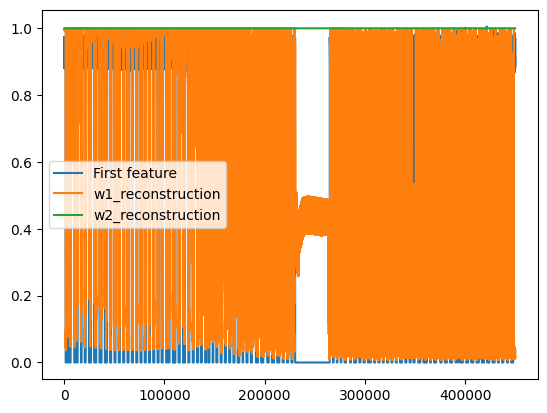

In [148]:
plt.plot(np.arange(len(attack.loc[:, 0])), attack.loc[:, 0], label = "First feature") #predicted_df_test.meter_reading[:8784]
plt.plot(np.arange(len(attack_w1_reco.loc[:, 0])), attack_w1_reco.loc[:, 0], label = "w1_reconstruction")
plt.plot(np.arange(len(attack_w2_reco.loc[:, 0])), attack_w2_reco.loc[:, 0], label = "w2_reconstruction")
plt.legend()
plt.show()

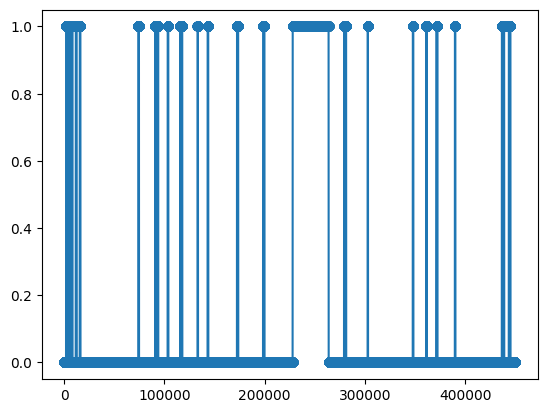

In [149]:
plt.plot(labels, marker = 'o')
plt.show()

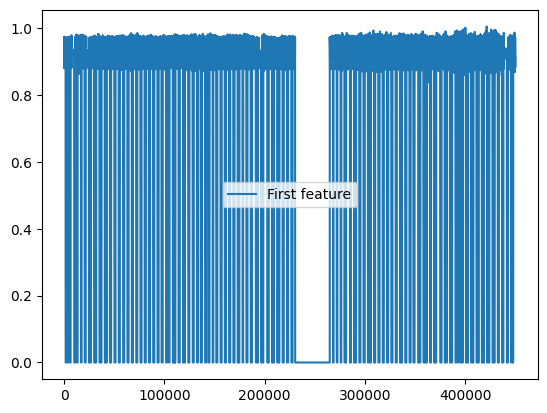

In [135]:
plt.plot(attack.loc[:, 0], label = "First feature")
plt.legend()
plt.show()

Let's try my anomaly detection method.

In [151]:
data = {'attack_gt': attack.loc[:, 0].values, 'attack_w1_reco': attack_w1_reco.loc[:, 0].values, 'attack_w2_reco': attack_w2_reco.loc[:, 0].values}

In [152]:
predicted_df_test = pd.DataFrame(data)

In [153]:
predicted_df_test

,attack_gt,attack_w1_reco,attack_w2_reco
0,0.884144,0.997100,1.0
1,0.891145,0.996004,1.0
2,0.906779,0.996470,1.0
3,0.923230,0.997167,1.0
4,0.935947,0.996053,1.0
...,...,...,...
449914,0.932563,0.038452,1.0
449915,0.928596,0.018675,1.0
449916,0.922179,0.012534,1.0
449917,0.918446,0.019591,1.0


In [155]:
predicted_df_test['relative_loss'] = np.abs((predicted_df_test['attack_w1_reco']-predicted_df_test['attack_gt'])/predicted_df_test['attack_w1_reco'])

In [156]:
predicted_df_test['relative_loss2'] = np.abs((predicted_df_test['attack_w2_reco']-predicted_df_test['attack_gt'])/predicted_df_test['attack_w2_reco'])

In [179]:
predicted_df_test

,attack_gt,attack_w1_reco,attack_w2_reco,relative_loss,relative_loss2,threshold,threshold2,predicted_anomaly,predicted_anomaly2
0,0.884144,0.997100,1.0,0.113285,0.115856,1.0,0.097655,0,1
1,0.891145,0.996004,1.0,0.105280,0.108855,1.0,0.097655,0,1
2,0.906779,0.996470,1.0,0.090009,0.093221,1.0,0.097655,0,0
3,0.923230,0.997167,1.0,0.074147,0.076770,1.0,0.097655,0,0
4,0.935947,0.996053,1.0,0.060344,0.064053,1.0,0.097655,0,0
...,...,...,...,...,...,...,...,...,...
449914,0.932563,0.038452,1.0,23.252712,0.067437,1.0,0.097655,1,0
449915,0.928596,0.018675,1.0,48.723473,0.071404,1.0,0.097655,1,0
449916,0.922179,0.012534,1.0,72.574790,0.077821,1.0,0.097655,1,0
449917,0.918446,0.019591,1.0,45.881284,0.081554,1.0,0.097655,1,0


In [172]:
#calculate threshold on relative loss quartiles but only on val, and in this case per 
val_loss = predicted_df_test.relative_loss.values
threshold = np.percentile(val_loss, 50)
predicted_df_test['threshold']= threshold

In [173]:
val_loss = predicted_df_test.relative_loss2.values
threshold = np.percentile(val_loss, 50)
#(np.percentile(val_loss, 75)) + 1.5 *((np.percentile(val_loss, 75))-(np.percentile(val_loss, 25)))
predicted_df_test['threshold2']= threshold

In [174]:
predicted_df_test['predicted_anomaly'] = predicted_df_test['relative_loss'] > predicted_df_test['threshold']
predicted_df_test['predicted_anomaly']=predicted_df_test['predicted_anomaly'].replace(False,0)
predicted_df_test['predicted_anomaly']=predicted_df_test['predicted_anomaly'].replace(True,1)

/tmp/ipykernel_15221/2648773490.py:3: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  predicted_df_test['predicted_anomaly']=predicted_df_test['predicted_anomaly'].replace(True,1)


In [175]:
predicted_df_test['predicted_anomaly2'] = predicted_df_test['relative_loss2'] > predicted_df_test['threshold2']
predicted_df_test['predicted_anomaly2']=predicted_df_test['predicted_anomaly2'].replace(False,0)
predicted_df_test['predicted_anomaly2']=predicted_df_test['predicted_anomaly2'].replace(True,1)

/tmp/ipykernel_15221/3307754308.py:3: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  predicted_df_test['predicted_anomaly2']=predicted_df_test['predicted_anomaly2'].replace(True,1)


In [176]:
from sklearn.metrics import classification_report

In [177]:
print(classification_report(labels, predicted_df_test['predicted_anomaly']))

              precision    recall  f1-score   support

         0.0       0.83      0.61      0.71    395298
         1.0       0.04      0.12      0.06     54621

    accuracy                           0.55    449919
   macro avg       0.44      0.37      0.38    449919
weighted avg       0.74      0.55      0.63    449919



In [178]:
print(classification_report(labels, predicted_df_test['predicted_anomaly2']))

              precision    recall  f1-score   support

         0.0       0.94      0.54      0.68    395298
         1.0       0.19      0.77      0.30     54621

    accuracy                           0.57    449919
   macro avg       0.57      0.65      0.49    449919
weighted avg       0.85      0.57      0.64    449919



In [180]:
roc_auc_score(labels, predicted_df_test['predicted_anomaly'])

0.3669290311617013

In [182]:
roc_auc_score(labels, predicted_df_test['predicted_anomaly2'])

0.6535811229998583

# Deprecated

In [59]:
results2, w1, w2 = testing_prova(model, test_loader)

In [60]:
results2

[tensor([0.0595, 0.0595, 0.0595,  ..., 0.0323, 0.0323, 0.0323], device='cuda:0'),
 tensor([0.0324, 0.0323, 0.0323,  ..., 0.2139, 0.2142, 0.2145], device='cuda:0'),
 tensor([0.2148, 0.2151, 0.2154,  ..., 0.0595, 0.0595, 0.0595], device='cuda:0'),
 tensor([0.0596, 0.0596, 0.0596,  ..., 0.0599, 0.0599, 0.0599], device='cuda:0'),
 tensor([0.0599, 0.0599, 0.0599,  ..., 0.0600, 0.0601, 0.0601], device='cuda:0'),
 tensor([0.0602, 0.0602, 0.0602,  ..., 0.0966, 0.0966, 0.0966], device='cuda:0'),
 tensor([0.0965, 0.0965, 0.0964,  ..., 0.0660, 0.0670, 0.0672], device='cuda:0'),
 tensor([0.0675, 0.0680, 0.0687,  ..., 0.0304, 0.0304, 0.0304], device='cuda:0'),
 tensor([0.0304, 0.0304, 0.0304,  ..., 0.0616, 0.0617, 0.0617], device='cuda:0'),
 tensor([0.0617, 0.0617, 0.0617,  ..., 0.0601, 0.0601, 0.0601], device='cuda:0'),
 tensor([0.0602, 0.0602, 0.0603,  ..., 0.0602, 0.0601, 0.0600], device='cuda:0'),
 tensor([0.0599, 0.0599, 0.0599,  ..., 0.0606, 0.0606, 0.0607], device='cuda:0'),
 tensor([0.0607,

In [61]:
len(w1), len(w1[0]), len(w1[0][0])

(57, 7919, 612)

La lunghezza di w1[0][0] è pari a 612 perchè quando abbiamo creato il test loader, gli abbiamo detto di passare da una dimensione pari a (n_batch, 12, 51) a (n_batch, 12 * 51), dove 12 * 51 è la w_size.

In [62]:
w1_reshaped = []
for el in w1:
  reshaped = torch.reshape(el, (el.size()[0], int(el.size()[1]/51), int(el.size()[1]/12)))
  w1_reshaped.append(reshaped)

In [63]:
first_feat_final = []
for batch in w1_reshaped:
  first_feature_windowed = []
  for batch_el in w1_reshaped[0]:
    first_feat = []
    for window in batch_el:
      first_feat.append(window[0].item())
    first_feature_windowed.append(first_feat)
  first_feat_final.append(first_feature_windowed)

In [64]:
first_feat_final

[[[0.9843287467956543,
   0.9845794439315796,
   0.9792977571487427,
   0.9860156774520874,
   0.9836736917495728,
   0.9815083146095276,
   0.9813317060470581,
   0.9779209494590759,
   0.9773844480514526,
   0.9809061288833618,
   0.9792003631591797,
   0.9848387241363525],
  [0.9848516583442688,
   0.9850725531578064,
   0.9799169898033142,
   0.9864861965179443,
   0.9841870665550232,
   0.9820939898490906,
   0.9819273352622986,
   0.9785996675491333,
   0.9780398607254028,
   0.9814897179603577,
   0.9798062443733215,
   0.9853194952011108],
  [0.9852967858314514,
   0.9854956269264221,
   0.9804524183273315,
   0.9868867993354797,
   0.9846228957176208,
   0.9825941920280457,
   0.9824411273002625,
   0.9791767001152039,
   0.9786015748977661,
   0.9819923639297485,
   0.980331540107727,
   0.9857352375984192],
  [0.985577404499054,
   0.9857625961303711,
   0.9807904958724976,
   0.9871394038200378,
   0.9848985075950623,
   0.9829099774360657,
   0.9827650189399719,
   0.97954

In [65]:
np.array(first_feat_final).shape

(57, 7919, 12)

In [ ]:
w2_reshaped = []
for el in w2:
  reshaped = torch.reshape(el, (el.size()[0], int(el.size()[1]/51), int(el.size()[1]/12)))
  w2_reshaped.append(reshaped)

In [ ]:
first_feat_final_w2 = []
for batch in w2_reshaped:
  first_feature_windowed_w2 = []
  for batch_el in batch:
    first_feat_w2 = []
    for window in batch_el:
      first_feat_w2.append(window[0].item())
    first_feature_windowed_w2.append(first_feat_w2)
  first_feat_final_w2.append(first_feature_windowed_w2)